## inference

In [1]:
import torch
import torchvision
from datasets import Dataset
from torchvision.transforms import v2
import numpy as np
import os
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:512"

if torch.backends.mps.is_built():
    device = torch.device('mps')
elif torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

In [2]:
device

device(type='cuda')

In [3]:
#!pip install --upgrade fused
import fused
import numpy as np

fused._env('prod')
fused.options.show.show_widget = False
fused.options.request_timeout = 180

In [4]:
fused.__version__

'1.5.4'

In [59]:
# from fused import NotebookCredentials
# credentials = NotebookCredentials()


Please open this link to authenticate with Fused:

* [https://dev-tjcykxcetrz6bps6.us.auth0.com/authorize?audience=fused-python-api&scope=openid+email+name+offline_access&response_type=code&client_id=CXiwKZQmmyo0rqXZY7pzBgfsF7AL2A9l&redirect_uri=https%3A%2F%2Fwww.fused.io%2Fnotebook_login_redirect&code_challenge_method=S256&code_challenge=9fUySmRLX94m5ktZ147ziLLlTsDyS0r8yPfoVtlAk8o](https://dev-tjcykxcetrz6bps6.us.auth0.com/authorize?audience=fused-python-api&scope=openid+email+name+offline_access&response_type=code&client_id=CXiwKZQmmyo0rqXZY7pzBgfsF7AL2A9l&redirect_uri=https%3A%2F%2Fwww.fused.io%2Fnotebook_login_redirect&code_challenge_method=S256&code_challenge=9fUySmRLX94m5ktZ147ziLLlTsDyS0r8yPfoVtlAk8o)

Once you have logged in, that page will give you a code which you can paste into this notebook to finish logging in.


In [60]:
#credentials.finalize(code="yJSghUaY_wsszsKB5-EitxfxlmdAxI5Tqy93A4meEvm6h")

You are now logged in to Fused. :rocket:

In [5]:
import pandas as pd

def rgb_to_hex(r, g, b):
    return '#{:02x}{:02x}{:02x}'.format(r, g, b)
    
df_cdl = pd.read_csv('/home/gabriel/Downloads/CDL_codes_names_colors.csv',header = None,index_col=1)
df_cdl = df_cdl.reset_index()
df_cdl.columns = ['name','code', 'R', 'G','B']
df_cdl_full = df_cdl
df_cdl_full = df_cdl_full.iloc[3:]
df_cdl_full = df_cdl_full.fillna(0).apply(pd.to_numeric, errors='ignore')
df_cdl_full=df_cdl_full.set_index('code',drop=True)

df_cdl_full['rgb'] = list(zip(df_cdl_full.R, df_cdl_full.G,df_cdl_full.B))
df_cdl_full['hex'] = df_cdl_full.apply(lambda x: rgb_to_hex(x.R,x.G,x.B),1)
dict_cdl = df_cdl_full['rgb'].to_dict()
dict_cdl_names = df_cdl_full['name'].to_dict()
dict_color_names =df_cdl_full.set_index('rgb')['name'].to_dict()
dict_name_hex = df_cdl_full.set_index('name')['hex'].to_dict()
dict_codes_names = {v:k for k,v in dict_cdl_names.items()}
dict_codes_names['Pumpkins'], dict_codes_names['Cherries']

(229, 66)

In [7]:
simple_dict = {'Alfalfa': 'OA',
 'Almonds': 'OA',
 'Apples': 'OA',
 'Barley': 'OA',
 'Barren': 'OT',
 'Carrots': 'OA',
 'Cherries': 'OA',
 'Chick Peas': 'OA',
 'Citrus': 'OA',
 'Clover/Wildflowers': 'OL',
 'Corn': 'CO',
 'Cotton': 'OA',
 'Cucumbers': 'OA',
 'Dbl Crop Barley/Corn': 'CO',
 'Dbl Crop Oats/Corn': 'CO',
 'Dbl Crop Triticale/Corn': 'CO',
 'Dbl Crop WinWht/Corn': 'CO',
 'Deciduous Forest': 'FW',
 'Developed/High Intensity': 'DV',
 'Developed/Low Intensity': 'DV',
 'Developed/Med Intensity': 'DV',
 'Developed/Open Space': 'DV',
 'Dry Beans': 'OA',
 'Evergreen Forest': 'FW',
 'Fallow/Idle Cropland': 'OL',
 'Garlic': 'OA',
 'Grapes': 'OA',
 'Grass/Pasture': 'OL',
 'Herbaceous Wetlands': 'FW',
 'Herbs': 'OA',
 'Lettuce': 'OA',
 'Misc Vegs & Fruits': 'OA',
 'Mixed Forest': 'FW',
 'Oats': 'OA',
 'Olives': 'OA',
 'Onions': 'OA',
 'Open Water': 'OW',
 'Other Crops': 'OA',
 'Other Hay/Non Alfalfa': 'OA',
 'Other Tree Crops': 'OA',
 'Peaches': 'OA',
 'Pears': 'OA',
 'Peas': 'OA',
 'Pecans': 'OA',
 'Peppers': 'OA',
 'Pistachios': 'OA',
 'Plums': 'OA',
 'Pop or Orn Corn': 'CO',
 'Prunes': 'OA',
 'Pumpkins': 'OA',
 'Rice': 'OA',
 'Rye': 'OA',
 'Safflower': 'OA',
 'Shrubland': 'OL',
 'Sod/Grass Seed': 'OL',
 'Sorghum': 'OA',
 'Squash': 'OA',
 'Strawberries': 'OA',
 'Sunflower': 'OA',
 'Sweet Corn': 'CO',
 'Sweet Potatoes': 'OA',
 'Tomatoes': 'OA',
 'Triticale': 'WH',
 'Walnuts': 'OA',
 'Watermelons': 'OA',
 'Winter Wheat': 'WH',
 'Woody Wetlands': 'FW',
 'Background': 'BG',
 'Soybeans': 'SB',
 'Peanuts': 'OA',
 'Tobacco': 'OA',
 'Mint': 'OA',
 'Durum Wheat': 'WH',
 'Spring Wheat': 'WH',
 'Other Small Grains': 'OA',
 'Dbl Crop WinWht/Soybeans': 'OA',
 'Millet': 'OA',
 'Speltz': 'OA',
 'Canola': 'OA',
 'Flaxseed': 'OA',
 'Rape Seed': 'OA',
 'Mustard': 'OA',
 'Camelina': 'OA',
 'Buckwheat': 'OA',
 'Sugarbeets': 'OA',
 'Potatoes': 'OA',
 'Sugarcane': 'OA',
 'Lentils': 'OA',
 'Caneberries': 'OA',
 'Hops': 'OA',
 'Switchgrass': 'OL',
 'Forest': 'FW',
 'Christmas Trees': 'OA',
 'Clouds/No Data': 'BG',
 'Developed': 'DV',
 'Water': 'OW',
 'Wetlands': 'FW',
 'Nonag/Undefined': 'BG',
 'Aquaculture': 'OW',
 'Perennial Ice/Snow ': 'BG',
 'Asparagus': 'OA',
 'Cantaloupes': 'OA',
 'Oranges': 'OA',
 'Honeydew Melons': 'OA',
 'Broccoli': 'OA',
 'Avocados': 'OA',
 'Pomegranates': 'OA',
 'Nectarines': 'OA',
 'Greens': 'OA',
 'Apricots': 'OA',
 'Vetch': 'OA',
 'Dbl Crop Lettuce/Durum Wht': 'OA',
 'Dbl Crop Lettuce/Cantaloupe': 'OA',
 'Dbl Crop Lettuce/Cotton': 'OA',
 'Dbl Crop Lettuce/Barley': 'OA',
 'Dbl Crop Durum Wht/Sorghum': 'OA',
 'Dbl Crop Barley/Sorghum': 'OA',
 'Dbl Crop WinWht/Sorghum': 'OA',
 'Dbl Crop WinWht/Cotton': 'OA',
 'Dbl Crop Soybeans/Cotton': 'OA',
 'Dbl Crop Soybeans/Oats': 'OA',
 'Dbl Crop Corn/Soybeans': 'OA',
 'Blueberries': 'OA',
 'Cabbage': 'OA',
 'Cauliflower': 'OA',
 'Celery': 'OA',
 'Radishes': 'OA',
 'Turnips': 'OA',
 'Eggplants': 'OA',
 'Gourds': 'OA',
 'Cranberries': 'OA',
 'Dbl Crop Barley/Soybeans': 'OA'}

In [8]:
df_cdl_full['simple_class'] = df_cdl_full['name'].apply(lambda x: simple_dict[x] if x!=' ' else 'BG') 
simple_class_numeric_dict = {k:v for v,k in enumerate(['BG','OW','DV', 'CO','SB', 'WH','OA', 'FW', 'OL','OT'])}
df_cdl_full['simple_class_numeric'] = df_cdl_full['simple_class'].apply(lambda x: simple_class_numeric_dict[x]) 
df_cdl_full.head()

,name,R,G,B,rgb,hex,simple_class,simple_class_numeric
code,,,,,,,,
0,Background,0,0,0,"(0, 0, 0)",#000000,BG,0
1,Corn,255,212,0,"(255, 212, 0)",#ffd400,CO,3
2,Cotton,255,38,38,"(255, 38, 38)",#ff2626,OA,6
3,Rice,0,169,230,"(0, 169, 230)",#00a9e6,OA,6
4,Sorghum,255,158,15,"(255, 158, 15)",#ff9e0f,OA,6


In [9]:
df_cdl_full[df_cdl_full['name'].str.contains('Soy')]

,name,R,G,B,rgb,hex,simple_class,simple_class_numeric
code,,,,,,,,
5,Soybeans,38,115,0,"(38, 115, 0)",#267300,SB,4
26,Dbl Crop WinWht/Soybeans,115,115,0,"(115, 115, 0)",#737300,OA,6
239,Dbl Crop Soybeans/Cotton,38,115,0,"(38, 115, 0)",#267300,OA,6
240,Dbl Crop Soybeans/Oats,38,115,0,"(38, 115, 0)",#267300,OA,6
241,Dbl Crop Corn/Soybeans,255,212,0,"(255, 212, 0)",#ffd400,OA,6
254,Dbl Crop Barley/Soybeans,38,115,0,"(38, 115, 0)",#267300,OA,6


## download training/testing data from hugging face

In [10]:
from datasets import load_dataset

dataset_train = load_dataset("gdurkin/cdl_hi_res_july_train",use_auth_token=True)['train'] #,download_mode = "force_redownload")['train']
dataset_test = load_dataset("gdurkin/cdl_hi_res_july_test",use_auth_token=True)['train'] #,download_mode = "force_redownload")['train']

/home/gabriel/.local/lib/python3.10/site-packages/datasets/load.py:2479: FutureWarning: 'use_auth_token' was deprecated in favor of 'token' in version 2.14.0 and will be removed in 3.0.0.
You can remove this warning by passing 'token=<use_auth_token>' instead.
  warnings.warn(
/home/gabriel/.local/lib/python3.10/site-packages/datasets/load.py:2479: FutureWarning: 'use_auth_token' was deprecated in favor of 'token' in version 2.14.0 and will be removed in 3.0.0.
You can remove this warning by passing 'token=<use_auth_token>' instead.
  warnings.warn(


In [11]:
def prep_dataset_train(examples):
    transform_seq = v2.Compose([v2.ToPILImage(),
                                #v2.RandomHorizontalFlip(p=0.3),
                                #v2.RandomVerticalFlip(p=0.3),
                                #v2.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.05, hue=0.05),
        #v2.RandomResizedCrop(scale=(0.25, 1.0),size=(512, 512), antialias=True),
                           v2.PILToTensor(),
                                v2.ToDtype(torch.float32, scale=True)
                               ]) 
    toPIL = v2.ToPILImage()
    images = [toPIL(x) for x in examples['pixel_values']]
    labels = [toPIL(y) for y in examples['labels']]
    aug_list = zip(images,labels)
    augmented_batch = [transform_seq(el) for el in aug_list]
    images, labels = zip(*augmented_batch) 
    encoding = {}
    encoding["pixel_values"] = [torch.tensor(el).float().to(device) for el in images]
    encoding['labels'] = [torch.tensor(el).long().squeeze().to(device) for el in labels]
    return encoding #{"pixel_values": encoding['pixel_values'], "labels": encoding['labels']} 

def prep_dataset_validate(examples):
    transform_seq = v2.Compose([v2.ToPILImage(),
                           v2.PILToTensor(),
                                v2.ToDtype(torch.float32, scale=True)
                               ]) 
    toPIL = v2.ToPILImage()
    images = [toPIL(x) for x in examples['pixel_values']]
    labels = [toPIL(y) for y in examples['labels']]
    aug_list = zip(images,labels)
    augmented_batch = [transform_seq(el) for el in aug_list]
    images, labels = zip(*augmented_batch) 
    encoding = {}
    encoding["pixel_values"] = [torch.tensor(el).float() for el in images]
    encoding['labels'] = [torch.tensor(el).long().squeeze() for el in labels]
    return encoding #{"pixel_values": encoding['pixel_values'], "labels": encoding['labels']} 

dataset_train.set_transform(prep_dataset_train)
dataset_test.set_transform(prep_dataset_validate)

In [12]:
class_color_dict = {0: 'background', 1: 'water', 2: 'developed', 3: 'corn', 
               4: 'soybeans', 5: 'wheat', 6: 'other agriculture', 
               7: 'forest/wetlands', 8: 'open lands', 9: 'barren'}

id2label = class_color_dict 
label2id = {v: k for k, v in id2label.items()}
num_labels = len(id2label)
print("Id2label:", id2label)
print("label2Id:", label2id)

Id2label: {0: 'background', 1: 'water', 2: 'developed', 3: 'corn', 4: 'soybeans', 5: 'wheat', 6: 'other agriculture', 7: 'forest/wetlands', 8: 'open lands', 9: 'barren'}
label2Id: {'background': 0, 'water': 1, 'developed': 2, 'corn': 3, 'soybeans': 4, 'wheat': 5, 'other agriculture': 6, 'forest/wetlands': 7, 'open lands': 8, 'barren': 9}


In [13]:
from transformers import MaskFormerForInstanceSegmentation, Mask2FormerForUniversalSegmentation
from transformers import MaskFormerImageProcessor, Mask2FormerImageProcessor
from torch.utils.data import DataLoader
mask2former_model ="gdurkin/cdl_mask2former_hi_res_v3"


test_model = Mask2FormerForUniversalSegmentation.from_pretrained(mask2former_model,
    label2id=label2id,
    id2label = id2label,
    num_labels=len(id2label),
    ignore_mismatched_sizes=True,
)

test_model = test_model.to(device)

In [14]:
# Create a preprocessor
preprocessor = Mask2FormerImageProcessor(ignore_index=0, reduce_labels=False, do_resize=False, do_rescale=False, do_normalize=False)

def collate_fn_mask(batch):
    if not isinstance(batch, list):
        batch = list(batch.items())  
    else:
        batch = batch#list(batch[0].items())
    images = [el['pixel_values'] for el in batch]
 
    segmentation_maps =  [el['labels'] for el in batch]
    
    try:
        batch = preprocessor(
            images,
            segmentation_maps=segmentation_maps,
            return_tensors="pt",
        )
        batch["original_images"] = images
        batch["original_segmentation_maps"] = segmentation_maps
    except:
        batch = None
    return batch

test_dataloader = DataLoader(dataset_test, batch_size=1, shuffle=False, collate_fn=collate_fn_mask)
train_dataloader = DataLoader(dataset_train, batch_size=8, shuffle=True, collate_fn=collate_fn_mask)

In [15]:
batch_test = next(iter(test_dataloader))

/tmp/ipykernel_4686/770773670.py:33: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  encoding["pixel_values"] = [torch.tensor(el).float() for el in images]
/tmp/ipykernel_4686/770773670.py:34: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  encoding['labels'] = [torch.tensor(el).long().squeeze() for el in labels]


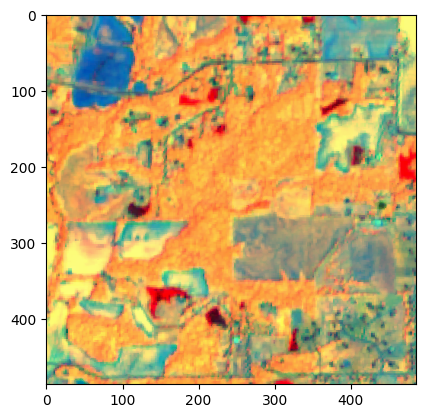

In [16]:
pixel_values = batch_test["pixel_values"][0].numpy()
import matplotlib.pyplot as plt
plt.imshow(pixel_values.transpose(1,2,0))

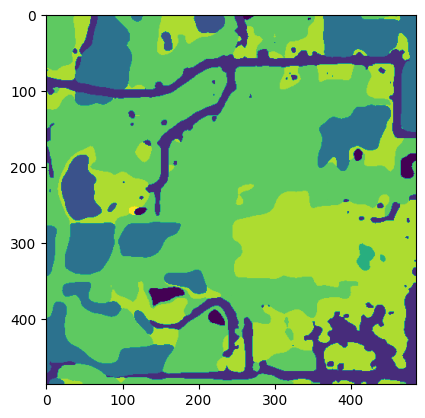

In [17]:
from PIL import Image

with torch.no_grad():
  outputs = test_model(batch_test["pixel_values"][0:1].to(device))

original_images = batch_test["original_images"]
target_sizes = [(original_images[0].shape[1],original_images[0].shape[2])]

# predict segmentation maps
predicted_segmentation_maps = preprocessor.post_process_semantic_segmentation(outputs, target_sizes=target_sizes)
plt.imshow(predicted_segmentation_maps[0].cpu().numpy())

In [18]:
def MF_predict(img,test_model):
    if isinstance(img, np.ndarray):
        img = torch.from_numpy(img).float()
    if torch.is_tensor(img):
        input_tensor = img
    else:
        input_tensor = pil_to_tensor(img)
    if len(input_tensor.shape)==3:
        input_tensor = input_tensor.unsqueeze(0)
    with torch.no_grad():
      outputs = test_model(input_tensor.to(device))
    target_sizes = [(input_tensor.shape[2],input_tensor.shape[3])]
    #print('target_sizes:',target_sizes)
    predicted_segmentation_maps = preprocessor.post_process_semantic_segmentation(outputs, target_sizes=target_sizes)
    return predicted_segmentation_maps[0].cpu().numpy()

In [19]:
MF_predict(batch_test["pixel_values"],test_model)

array([[7, 7, 7, ..., 4, 4, 4],
       [7, 7, 7, ..., 4, 4, 4],
       [7, 7, 7, ..., 4, 4, 4],
       ...,
       [2, 2, 2, ..., 2, 2, 2],
       [2, 2, 2, ..., 2, 2, 2],
       [2, 2, 2, ..., 2, 2, 2]])

In [20]:
from PIL import Image
from itertools import product
import gc

#this function creates a mosaic of the image, can rotate the mosaic tiles through 90 degrees before predicting, and then stitching everything back together in the right order

def tile_and_predict(img_png, model, d=256,rot=0):
    k=0
    if torch.is_tensor(img_png) or isinstance(img_png, np.ndarray):
        img_png = to_pil_image(img_png)
    tile_list = []
    w, h = img_png.size
    print('original image size:', w,h)
    img_area = (0, 0,  w-w%d,h-h%d)
    img_png = img_png.crop(img_area)
    ww, hh = img_png.size
    print('tiled image size:',ww,hh)
    grid = product(range(0, h-h%d, d), range(0, w-w%d, d))
    for i, j in grid:
        box = (j, i, j+d, i+d)
        tile = img_png.crop(box)
        pred_seg = MF_predict(tile.rotate(rot),model)
        rot_factor = -1*(rot//90)
        tile_list += [np.rot90(pred_seg,rot_factor)]
        pred_seg= None
        with torch.no_grad():
            torch.cuda.empty_cache()
            gc.collect() 
        k+=1
        #print('tile ',k)
    pred_array = np.array(tile_list)
    tiles = pred_array.reshape(hh//d,ww//d,d,d).swapaxes(1, 2).reshape(hh,ww)
    return img_png, tiles

In [23]:
# define our udf calls to sentintel 2 and the cropland data layer

udf_s2 = fused.load("gabriel@fused.io/S2_3ch")
udf_cdl = fused.load("gabriel@fused.io/CDL_mask")

In [1]:
#udf_s2

In [26]:
# make some python wrappers on the udfs that have bounds only as main argument - then can be passed to async for parallel querying of different tiles

def bounds_to_s2(bounds,fused_udf=udf_s2,zoom = "14",
                     time_of_interest="2022-07-01/2022-07-13",
                    cloud_cover_perc="15",
                     pixel_perc = "95"):
    s2_xarr = fused.run(udf=fused_udf,
                    west=bounds[0], 
                     south=bounds[1], 
                     east = bounds[2], 
                     north = bounds[3],
                     time_of_interest=time_of_interest, cloud_cover_perc=cloud_cover_perc,pixel_perc = pixel_perc,zoom=zoom)
    s2_img = np.transpose(np.array(s2_xarr.image[0:3],'uint8'),(1,2,0))
    return s2_img, bounds


def bounds_to_cdl(bounds,year="2022"):
    cdl_xarr = fused.run(udf=udf_cdl,
                    west=bounds[0], 
                     south=bounds[1], 
                     east = bounds[2], 
                     north = bounds[3],
                     year=year)
    cdl_img = np.transpose(np.array(cdl_xarr.image[0:3],'uint8'),(1,2,0))
    return cdl_img, bounds


def bounded_udf_fusion(bounds,year="2022",zoom="14",time_of_interest="2022-07-01/2022-07-14",
                    cloud_cover_perc="15",
                     pixel_perc = "95"):
    return fused.core.run_file("gabriel@fused.io", "S2_CDL_fusion", 
                                west=bounds[0], south=bounds[1], east = bounds[2], north = bounds[3],
                                zoom = zoom,
                                year=year,time_of_interest=time_of_interest,cloud_cover_perc = cloud_cover_perc, pixel_perc = pixel_perc)
    
#wrap in a function with only one variable to use wuth asnyc
def bounds_to_fusion(drawn_bounds):
    xarr = bounded_udf_fusion(drawn_bounds)
    img = np.transpose(np.array(xarr.image[0:4],'uint8'),(1,2,0))
    return img, drawn_bounds

### some helper functions

In [27]:
import shapely
k_ring_count = 0 
def bounds_to_gdf(bounds_list, crs = 4326):
    box = shapely.box(*bounds_list)
    return gpd.GeoDataFrame(geometry=[box], crs=crs)

def run_async(fn, arr_args, delay=0, max_workers=None):
    import numpy as np
    import concurrent.futures
    import time 
    if max_workers is None:
        max_workers = min(len(arr_args), 32)
    pool = concurrent.futures.ThreadPoolExecutor(max_workers=max_workers)
    def delayed_fn(*args, **kwargs):
        time.sleep(delay * np.random.random())
        return fn(*args, **kwargs)
    fn2 = fn if delay == 0 else delayed_fn
    return [r for r in pool.map(fn2, arr_args)]

def poly_fill(geom, zooms=[15], compact=True, k=None):
    import mercantile
    import shapely
    import geopandas as gpd
    tile_list = list(mercantile.tiles(*geom.bounds,zooms=zooms))
    gdf_tiles = gpd.GeoDataFrame(tile_list, geometry=[shapely.box(*mercantile.bounds(i)) for i in tile_list], crs=4326)
    gdf_tiles_intersecting = gdf_tiles[gdf_tiles.intersects(geom)]
    if k: 
        temp_list = gdf_tiles_intersecting.apply(lambda row:mercantile.Tile(row.x,row.y,row.z),1)
        clip_list = k_ring_list(temp_list,k)
        if not compact:
            gdf = gpd.GeoDataFrame(clip_list, geometry=[shapely.box(*mercantile.bounds(i)) for i in clip_list], crs=4326)
            return gdf
    else:
        if not compact:
            return gdf_tiles_intersecting
        clip_list = gdf_tiles_intersecting.apply(lambda row:mercantile.Tile(row.x,row.y,row.z),1)
    simple_list = mercantile.simplify(clip_list)
    gdf = gpd.GeoDataFrame(simple_list, geometry=[shapely.box(*mercantile.bounds(i)) for i in simple_list], crs=4326)
    return gdf#.reset_index(drop=True)

def k_ring(tile, k):
    #ToDo: Remove invalid tiles in the globe boundries (e.g. negative values)
    import mercantile
    result = []
    for x in range(tile.x - k, tile.x + k + 1):
        for y in range(tile.y - k, tile.y + k + 1):
            result.append(mercantile.Tile(x, y, tile.z))
    return result

def k_ring_list(tiles, k):
    a = []
    for tile in tiles:
        a.extend(k_ring(tile, k))
    return list(set(a))
    
def make_tiles_gdf(bounds,zoom = 14):
    df_tiles = poly_fill(shapely.box(*bounds), zooms=[zoom], compact=0, k=k_ring_count)
    df_tiles['bounds'] = df_tiles['geometry'].apply(lambda x:x.bounds,1)
    return df_tiles

In [28]:
import geopandas as gpd
import rasterio
from rasterio.transform import from_gcps
from rasterio.control import GroundControlPoint as GCP
from rasterio.warp import reproject, Resampling
import PIL
from io import StringIO, BytesIO
from base64 import b64encode

def center_of_bounds(bb):
    return 0.5*(bb[2] + bb[0]), 0.5*(bb[3] + bb[1])

def reproject_raster(arr,bounds, crs_in = 4326, crs_out = 3857):
    #arr = np.squeeze(arr)
    bbox_src = bounds_to_gdf(bounds, crs = crs_in)
    bbox_dest = bounds_to_gdf(bounds, crs = crs_out)
    with rasterio.Env():
        ul = (bounds[0], bounds[3])  # in lon, lat / x, y order
        ll = (bounds[0], bounds[1])
        ur = (bounds[2], bounds[3])
        lr = (bounds[2], bounds[1])
        #print('input shape:',arr.shape)
        rows, cols, depth = arr.shape
        
        gcps = [
            GCP(0, 0, *ul),
            GCP(0, cols, *ur),
            GCP(rows, 0, *ll),
            GCP(rows, cols, *lr)
        ]
        
        src_transform = from_gcps(gcps)
        #{'init': 'EPSG:4326'}109.860781,-0.839758,110.158949,-0.631284

        source = np.squeeze(arr)
    
        dst_crs = crs_out #{'init': 'EPSG:3857'}
        dst_transform, width, height = rasterio.warp.calculate_default_transform(crs_in, crs_out, cols, rows, *bbox_dest.total_bounds)
        if depth ==1:
            dst_shape =  height, width
        else:
            dst_shape =  max(rows,height), max(width,cols), depth
        #print('destination shape:',dst_shape)
        destination = np.zeros(dst_shape)
    
        reproject(
            source,
            destination,
            src_transform=src_transform,
            src_crs=crs_in,
            dst_transform=dst_transform,
            dst_crs=crs_out,
            resampling=Resampling.nearest)
    
    arr_web = destination
    return arr_web

# def ceildiv(a,b):
#     return int(- (a // -b))

def divide_and_conquer(bb, udf_fn=bounds_to_s2, zm = 12):
    gdf_tiles = make_tiles_gdf(bb,zoom = zm)
    coords_total = gdf_tiles.total_bounds
    xdim_total = coords_total[2] - coords_total[0]
    ydim_total = coords_total[3] - coords_total[1]

    coords = np.array(gdf_tiles.iloc[0]['bounds'])
    xdim = coords[2] - coords[0]
    ydim = coords[3] - coords[1]
    x_cnt = int(xdim_total//xdim)
    y_cnt = int(ydim_total//ydim)
    # x_cnt = ceildiv(xdim_total,xdim) 
    # y_cnt = ceildiv(ydim_total,ydim) 
    tile_list = list(gdf_tiles['bounds'].values)
    if len(tile_list)>300:
        print('there are ',len(tile_list), 'tiles, too large a bbox, shrink it until there are less than 300 tiles')
    pair_list = run_async(udf_fn, tile_list, delay=0., max_workers=300)
    print('got pair list')
    pair_list_mercator = [(reproject_raster(img,bounds, crs_in = 4326, crs_out = 3857),bounds) for img,bounds in pair_list]
    
    hlist = [pair_list_mercator[i][0].shape[0] for i in range(len(pair_list_mercator))]
    wlist = [pair_list_mercator[i][0].shape[1] for i in range(len(pair_list_mercator))]
    h = min(hlist)
    w = min(wlist)
    print('img dims:',h,w)
    try:
        depth = pair_list_mercator[0][0].shape[2]
    except:
        depth = 1
        pair_list_mercator = [(np.expand_dims(tup[0], axis=2),tup[1]) for tup in pair_list_mercator] 
    hw = min(h,w)
    img_list = [tup[0][:hw,:hw,:] for tup in pair_list_mercator] 

    loc_list = [center_of_bounds(tup[1]) for tup in pair_list_mercator]
    print('img loc:',loc_list[0])
    zipped_list = list(zip(loc_list,img_list))
    sorted_list = sorted(zipped_list, key=lambda x: (x[0][1],-x[0][0]))
    #sorted_list = sorted(zipped_list, key=lambda x: x[0][1])
    img_arr = np.array([el[1] for el in sorted_list])
    # if depth!=4:
    #     stitched_img = img_arr[::-1].reshape(y_cnt,x_cnt,hw,hw,depth).swapaxes(1,2).reshape(y_cnt*hw,x_cnt*hw,depth)
    # else:
    #     return img_arr
    try:
        stitched_img = img_arr[::-1].reshape(y_cnt,x_cnt,hw,hw,depth).swapaxes(1,2).reshape(y_cnt*hw,x_cnt*hw,depth)
    except:
        y_cnt+=1
    try:
        stitched_img = img_arr[::-1].reshape(y_cnt,x_cnt,hw,hw,depth).swapaxes(1,2).reshape(y_cnt*hw,x_cnt*hw,depth)
    except:
        y_cnt = y_cnt-1
        x_cnt +=1
    try:
        stitched_img = img_arr[::-1].reshape(y_cnt,x_cnt,hw,hw,depth).swapaxes(1,2).reshape(y_cnt*hw,x_cnt*hw,depth)
    except:
        y_cnt+=1
    stitched_img = img_arr[::-1].reshape(y_cnt,x_cnt,hw,hw,depth).swapaxes(1,2).reshape(y_cnt*hw,x_cnt*hw,depth)
    return np.array(stitched_img,'uint8')

### test to retreive large image, by first mosaicing and making parallel async calls for each mosaic tile

In [29]:
%%time
borneo_bbox = [109.860781,-0.839758,110.158949,-0.631284]

def bounds_to_s2_2019(drawn_bounds):
    s2_img, bounds = bounds_to_s2(drawn_bounds,zoom="14",time_of_interest="2019-06-01/2019-12-30",
                    cloud_cover_perc="5",
                     pixel_perc = "80")
    return s2_img, bounds

img_arr_borneo = divide_and_conquer(borneo_bbox, udf_fn=bounds_to_s2_2019,zm = 12)

/home/gabriel/.local/lib/python3.10/site-packages/geopandas/geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)
/home/gabriel/.local/lib/python3.10/site-packages/xarray/core/common.py:165: RuntimeWarning: invalid value encountered in cast
  return np.asarray(self.values, dtype=dtype)
/home/gabriel/.local/lib/python3.10/site-packages/xarray/core/common.py:165: RuntimeWarning: invalid value encountered in cast
  return np.asarray(self.values, dtype=dtype)
/home/gabriel/.local/lib/python3.10/site-packages/xarray/core/common.py:165: RuntimeWarning: invalid value encountered in cast
  return np.asarray(self.values, dtype=dtype)
/home/gabriel/.local/lib/python3.10/site-packages/xarray/core/common.py:165: RuntimeWarning: invalid value encountered in cast
  return np.asarr

got pair list
img dims: 979 979
img loc: (109.8193359375, -0.659164952421665)
CPU times: user 10.7 s, sys: 921 ms, total: 11.7 s
Wall time: 7.79 s


Text(0.5, 1.0, 'Deforestation in Borneo (2019)')

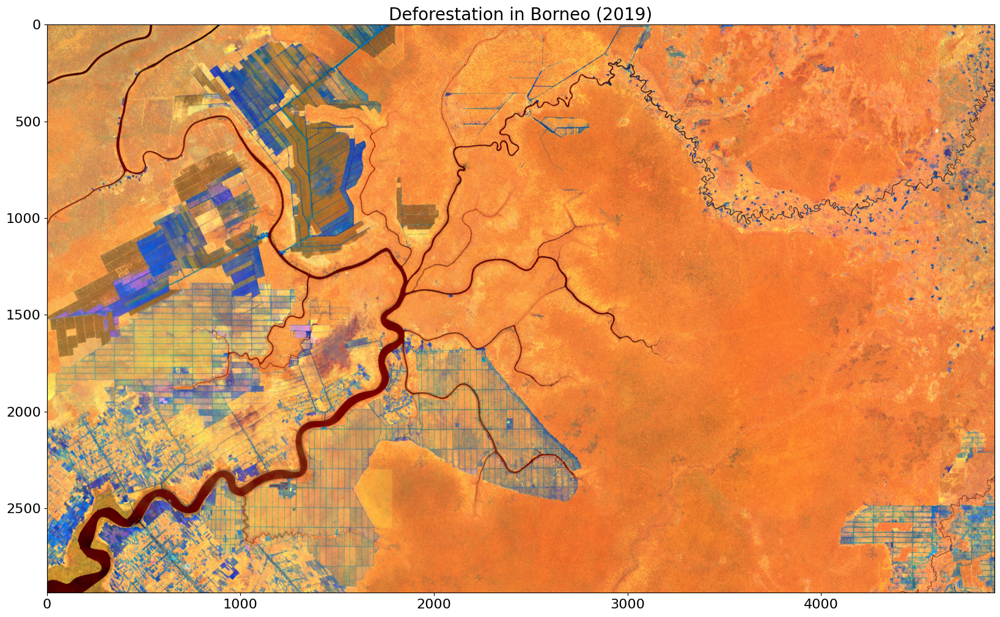

In [30]:
import matplotlib as mpl
mpl.rcParams['xtick.labelsize'] =16
mpl.rcParams['ytick.labelsize'] =16
fig, ax = plt.subplots(figsize = (20,20))
plt.imshow(img_arr_borneo)
plt.title('Deforestation in Borneo (2019)',size = 20)
#plt.savefig('springfield_july.png', bbox_inches='tight')

### choose some holdout regions: santa maria, CA and springfield, IL

In [ ]:
# get bounding boxes here: https://boundingbox.klokantech.com/

In [35]:
rgb_dict = df_cdl_full[['rgb']].to_dict()['rgb']
class_list = list(simple_class_numeric_dict.keys())
class_list

['BG', 'OW', 'DV', 'CO', 'SB', 'WH', 'OA', 'FW', 'OL', 'OT']

In [46]:
%%time

bbox_santamaria = [-120.572265,34.875528,-120.286621,35.090837]
  
img_mask_arr_sm = divide_and_conquer(bbox_santamaria, udf_fn=bounds_to_fusion,zm = 12)
img_arr_sm = img_mask_arr_sm[:,:,:3]

got pair list
img dims: 978 978
img loc: (-120.5419921875, 35.06596521313586)
CPU times: user 9.56 s, sys: 1.44 s, total: 11 s
Wall time: 4min 41s


Text(0.5, 1.0, 'Sentintel 2 Holdout Image: Santa Maria Vineyards, CA (Early July 2022)')

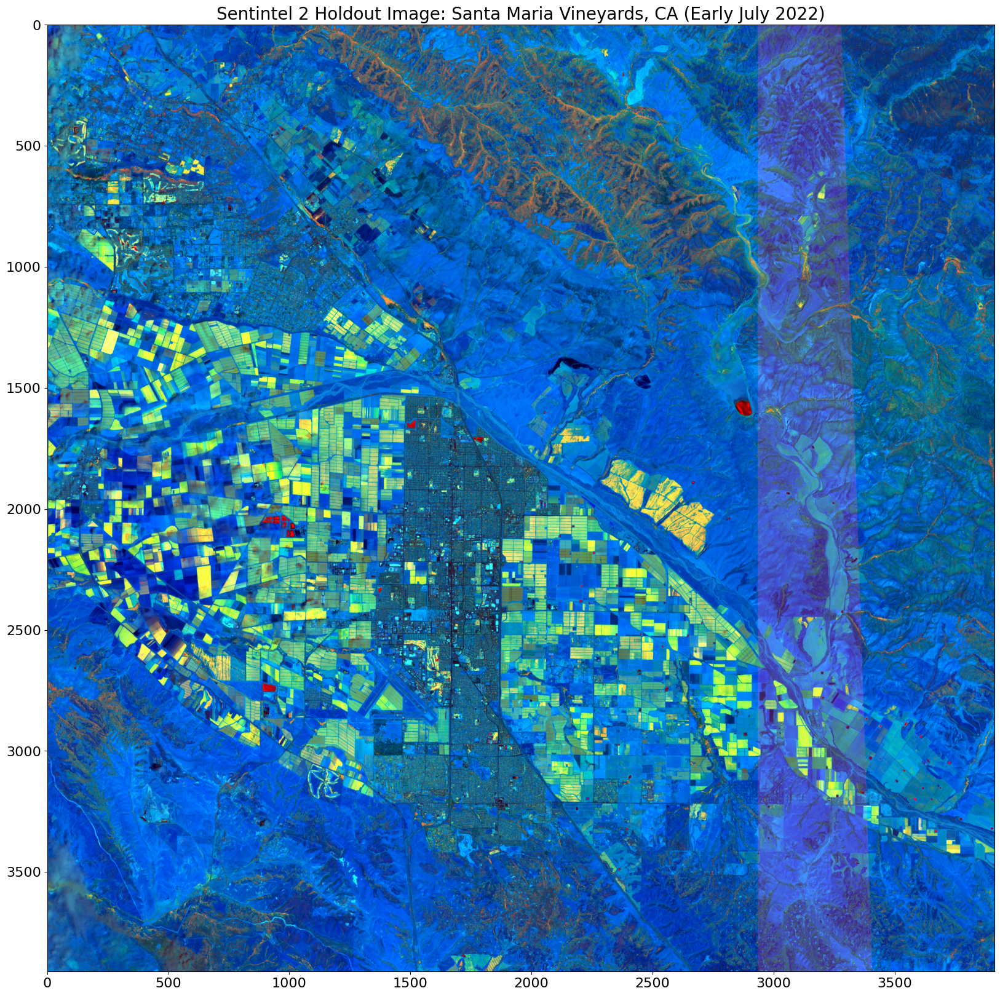

In [47]:
import matplotlib as mpl
mpl.rcParams['xtick.labelsize'] =16
mpl.rcParams['ytick.labelsize'] =16
fig, ax = plt.subplots(figsize = (20,20))
plt.imshow(img_arr_sm)
plt.title('Sentintel 2 Holdout Image: Santa Maria Vineyards, CA (Early July 2022)',size = 20)
#plt.savefig('springfield_july.png', bbox_inches='tight')

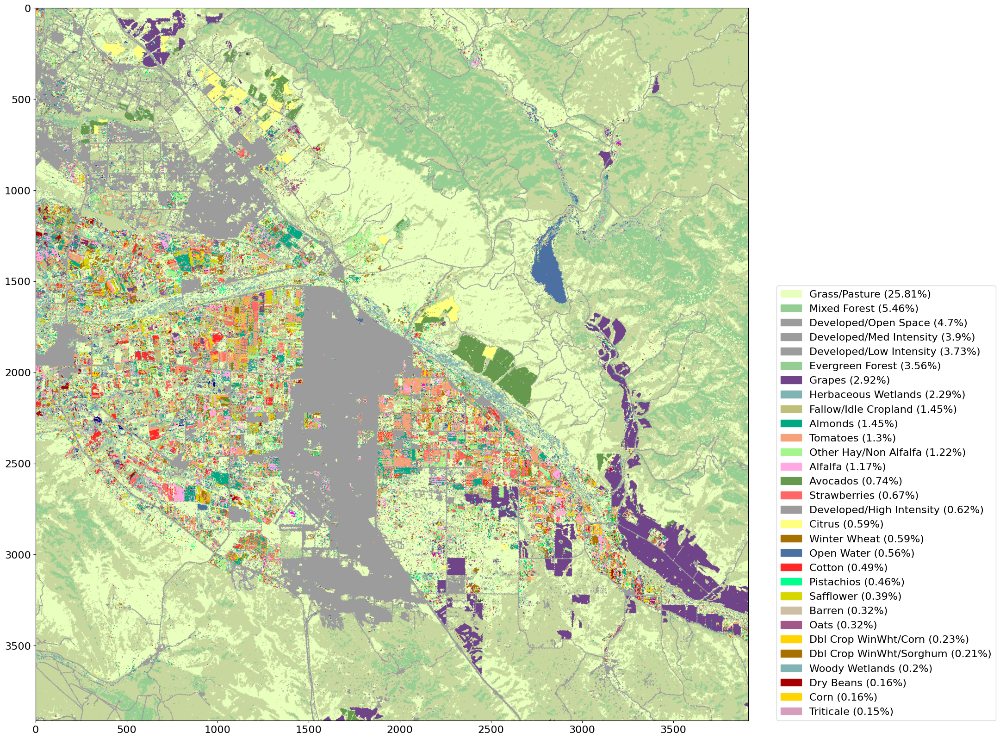

In [61]:
import matplotlib.patches as mpatches
cdl_mask = np.expand_dims(img_mask_arr_sm[:,:,3],axis=2)


def vec_translate(a, my_dict):
    return np.vectorize(my_dict.__getitem__)(a)
cdl_tup = vec_translate(cdl_mask, rgb_dict)
cdl_img = np.array(cdl_tup)[:,:,:,0].transpose(1,2,0)


fig, ax = plt.subplots(figsize = (20,20))

pixel_array = np.array(np.unique(cdl_mask, return_counts = True)).T
pixels_ordered = pixel_array[pixel_array[:, 1].argsort()[::-1]]
df_pixel = pd.DataFrame(pixels_ordered, columns = ['code','count'])
df_pixel_join = df_pixel.merge(df_cdl_full.reset_index(), on = 'code')[['code', 'count', 'name', 'simple_class',
       'simple_class_numeric','rgb']]
df_pixel_join['perc'] = np.round(100.*df_pixel_join['count']/df_pixel_join[df_pixel_join['simple_class_numeric']!= 0]['count'].sum(),2)
df_pixel_join['name_perc'] = df_pixel_join.apply(lambda x: x['name'] + ' (' + str(x['perc']) + '%)',1)
df_pixel_join.loc[df_pixel_join.code == 0, 'name_perc'] = 'N/A'

names_colors_dict = df_pixel_join.iloc[1:31][['name_perc','rgb']].set_index('name_perc').to_dict()['rgb']

ax.imshow(cdl_img)
labels_handles = list(zip(*[( nm, mpatches.Patch(color=np.array(cl)/255.)) for nm,cl in names_colors_dict.items()]))
plt.legend(labels_handles[1], labels_handles[0], loc=(1.04, 0),prop={'size': 16})

### holdout prediction

In [62]:
import numpy as np
from PIL import Image as Img
def to_pil_image(image, rescale=None):
        """
        Converts :obj:`image` to a PIL Image. Optionally rescales it and puts the channel dimension back as the last
        axis if needed.

        Args:
            image (:obj:`PIL.Image.Image` or :obj:`numpy.ndarray` or :obj:`torch.Tensor`):
                The image to convert to the PIL Image format.
            rescale (:obj:`bool`, `optional`):
                Whether or not to apply the scaling factor (to make pixel values integers between 0 and 255). Will
                default to :obj:`True` if the image type is a floating type, :obj:`False` otherwise.
        """
        #self._ensure_format_supported(image)

        if torch.is_tensor(image):
            image = image.numpy()

        if isinstance(image, np.ndarray):
            if rescale is None:
                # rescale default to the array being of floating type.
                rescale = isinstance(image.flat[0], np.floating)
            # If the channel as been moved to first dim, we put it back at the end.
            if image.ndim == 3 and image.shape[0] in [1, 3]:
                image = image.transpose(1, 2, 0)
            if rescale:
                image = image * 255
            image = image.astype(np.uint8)
            return Img.fromarray(image)
        return image

def pil_to_tensor(img):
    return v2.ToTensor()(img)

In [50]:
%%time
tile_predict_sm = tile_and_predict(img_arr_sm,test_model, d=950*2)

original image size: 3912 3912
tiled image size: 3800 3800
CPU times: user 25.3 s, sys: 1.39 s, total: 26.7 s
Wall time: 20.3 s


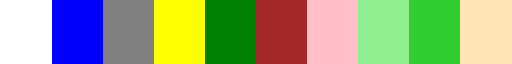

In [63]:
import matplotlib as mpl
from matplotlib import colors

def named_color_array(name_list = ['white','blue','grey','yellow','green','brown','pink','olive','limegreen','orange']):
    return [colors.cnames[el] for el in name_list]

cmap_pinkgrapes = mpl.colors.LinearSegmentedColormap.from_list('cdl_cmap', named_color_array(name_list = ['white','blue','grey','yellow','green','brown','pink','lightgreen','limegreen','moccasin']),10)
cmap_pinkgrapes

In [64]:
gt_labels.shape,  tile_predict[1].shape

((3800, 3800), (3800, 3800))

Santa Maria IOU Mask2former:  [('BG', 0), ('OW', 6), ('DV', 49), ('CO', 0), ('SB', 0), ('WH', 0), ('OA', 35), ('FW', 38), ('OL', 64), ('OT', 0)]


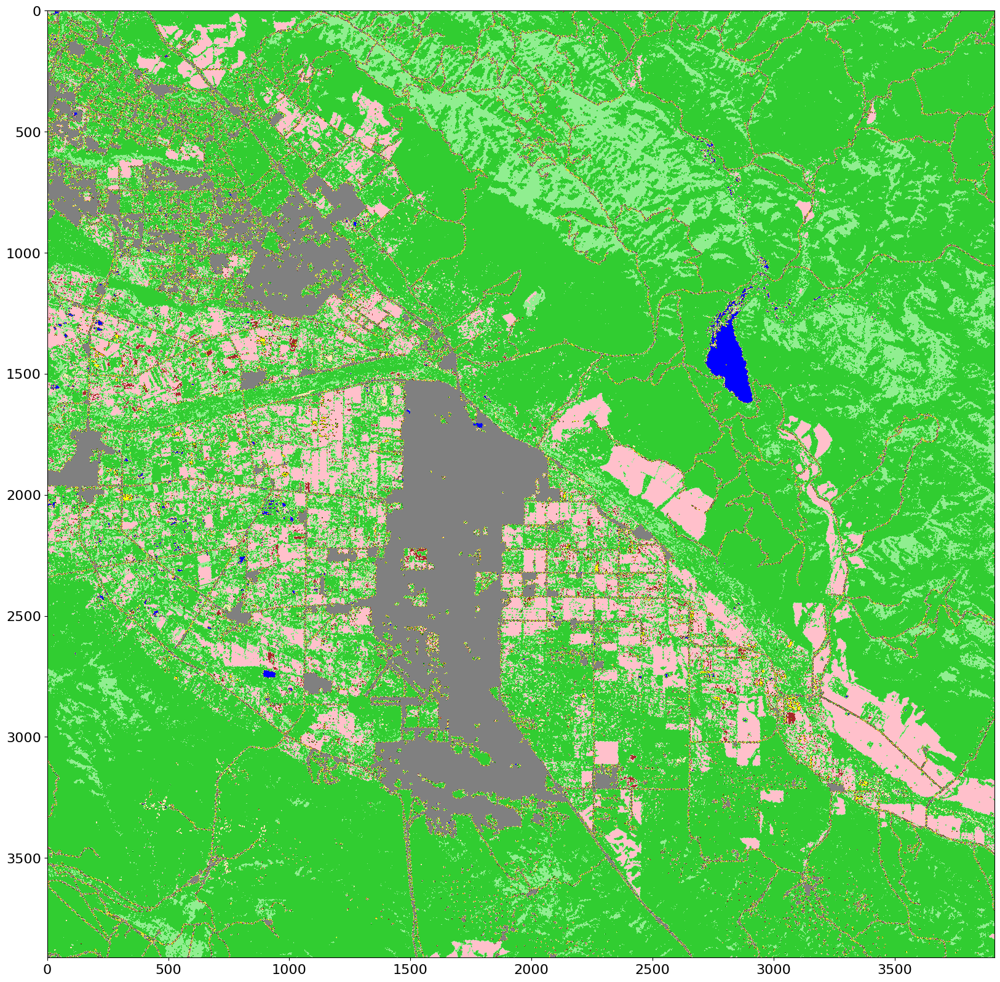

In [76]:
from sklearn.metrics import jaccard_score
tile_predict = tile_predict_sm
MF_model_out = tile_predict[1]

code_class_dict = df_cdl_full[['simple_class_numeric']].to_dict()['simple_class_numeric']

gt_labels =  vec_translate(cdl_mask, code_class_dict)
gt_labels = gt_labels[:tile_predict[1].shape[0],:tile_predict[1].shape[1],0]
jax_array_MF = jaccard_score(np.round(gt_labels).reshape(-1),np.round(np.array(MF_model_out)).reshape(-1), average=None,labels = [0,1,2,3,4,5,6,7,8,9])
print("Santa Maria IOU Mask2former: ",list(zip(class_list,np.array(100*jax_array_MF,'uint8'))))
np.array(100*jax_array_MF,'uint8')

fig, ax = plt.subplots(figsize = (20,20))
cdl_simple = vec_translate(cdl_mask, code_class_dict)
plt.imshow(cdl_simple, cmap=cmap_pinkgrapes, vmin = 0,vmax = 9) 

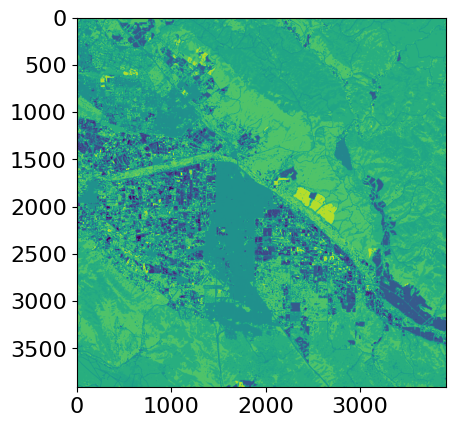

In [110]:
cdl_mask = np.expand_dims(img_mask_arr_sm[:,:,3],axis=2)
plt.imshow(cdl_mask)

Text(0.5, 1.0, 'Holdout: Predicting developed and agricultural land use (Santa Maria, CA)')

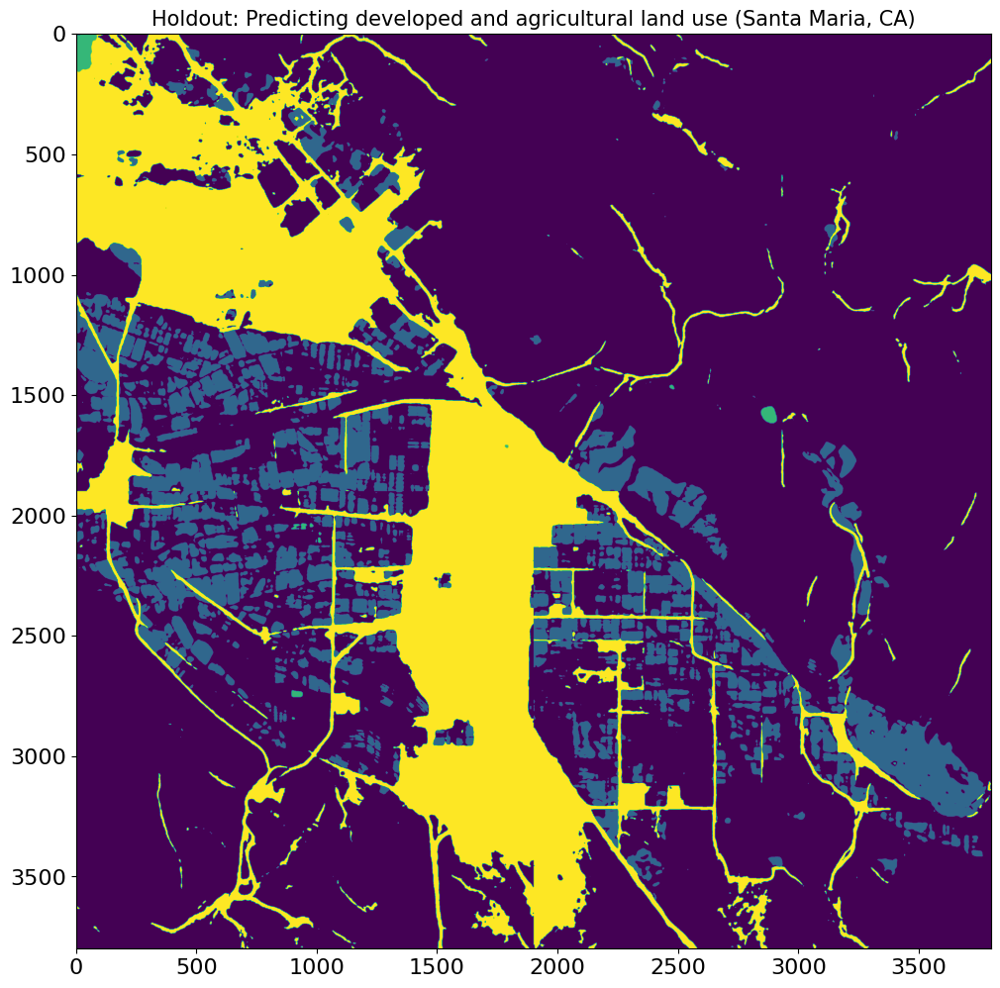

In [127]:
fig, ax = plt.subplots(figsize = (12,12))
pred_mask_dev = np.squeeze(1*tile_predict[1] == 2)
pred_mask_agri = np.squeeze(1*tile_predict[1] == 6)
pred_mask_water = np.squeeze(1*tile_predict[1] == 1)
plt.imshow(pred_mask_agri+2*pred_mask_water+3*pred_mask_dev)
plt.title('Holdout: Predicting developed and agricultural land use (Santa Maria, CA)',fontsize = 15)

(3800, 3800, 3)


Text(0.5, 1.0, 'Holdout near Santa Maria, CA (Early July 2022) - Predicted Agriculture incl. Vineyards')

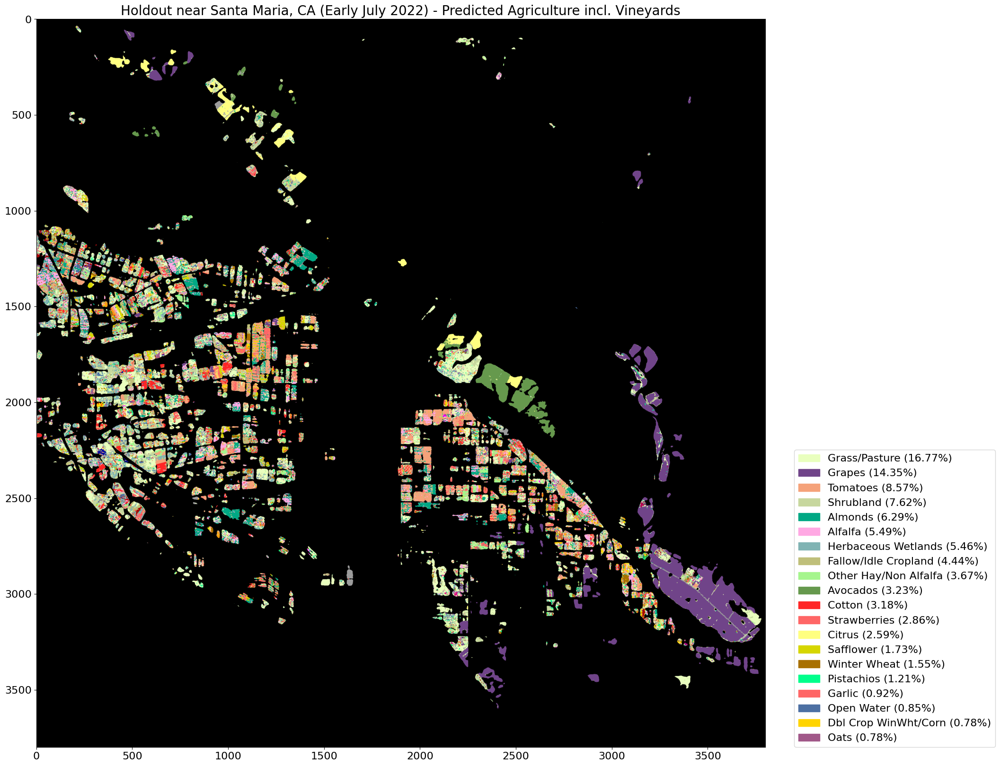

In [126]:
import matplotlib as mpl

mpl.rcParams['xtick.labelsize'] =16
mpl.rcParams['ytick.labelsize'] =16
fig, ax = plt.subplots(figsize = (20,20))

#gt_labels =  vec_translate(cdl_mask, code_class_dict)
#gt_labels = gt_labels[:tile_predict[1].shape[0],:tile_predict[1].shape[1],0]

cdl_tup = vec_translate(cdl_mask, rgb_dict)
cdl_img = np.array(cdl_tup)[:,:,:,0].transpose(1,2,0)
pred_mask = np.squeeze(1*tile_predict[1] == 6)#other agriculture, e.g. avocado, grapes
pred_mask3 = np.array([pred_mask,pred_mask,pred_mask]).transpose(1,2,0)

print(pred_mask3.shape)

cdl_mask_trim =cdl_mask[:pred_mask.shape[0],:pred_mask.shape[1],0]
cdl_img_trim =cdl_img[:pred_mask.shape[0],:pred_mask.shape[1],:]


pixel_array = np.array(np.unique(pred_mask*cdl_mask_trim, return_counts = True)).T
pixels_ordered = pixel_array[pixel_array[:, 1].argsort()[::-1]]
df_pixel = pd.DataFrame(pixels_ordered, columns = ['code','count'])
df_pixel_join = df_pixel.merge(df_cdl_full.reset_index(), on = 'code')[['code', 'count', 'name', 'simple_class',
       'simple_class_numeric','rgb']]
df_pixel_join['perc'] = np.round(100.*df_pixel_join['count']/df_pixel_join[df_pixel_join['simple_class_numeric']!= 0]['count'].sum(),2)
df_pixel_join['name_perc'] = df_pixel_join.apply(lambda x: x['name'] + ' (' + str(x['perc']) + '%)',1)
df_pixel_join.loc[df_pixel_join.code == 0, 'name_perc'] = 'N/A'

names_colors_dict_mask = df_pixel_join.iloc[1:21][['name_perc','rgb']].set_index('name_perc').to_dict()['rgb']

ax.imshow(pred_mask3*cdl_img_trim)
labels_handles = list(zip(*[( nm, mpatches.Patch(color=np.array(cl)/255.)) for nm,cl in names_colors_dict_mask.items()]))
plt.legend(labels_handles[1], labels_handles[0], loc=(1.04, 0),prop={'size': 16})
plt.title('Holdout near Santa Maria, CA (Early July 2022) - Predicted Agriculture incl. Vineyards',size = 20)

(3800, 3800, 3)


Text(0.5, 1.0, 'Holdout near Santa Maria, CA (Early July 2022) - Predicted Forests and Wetlands')

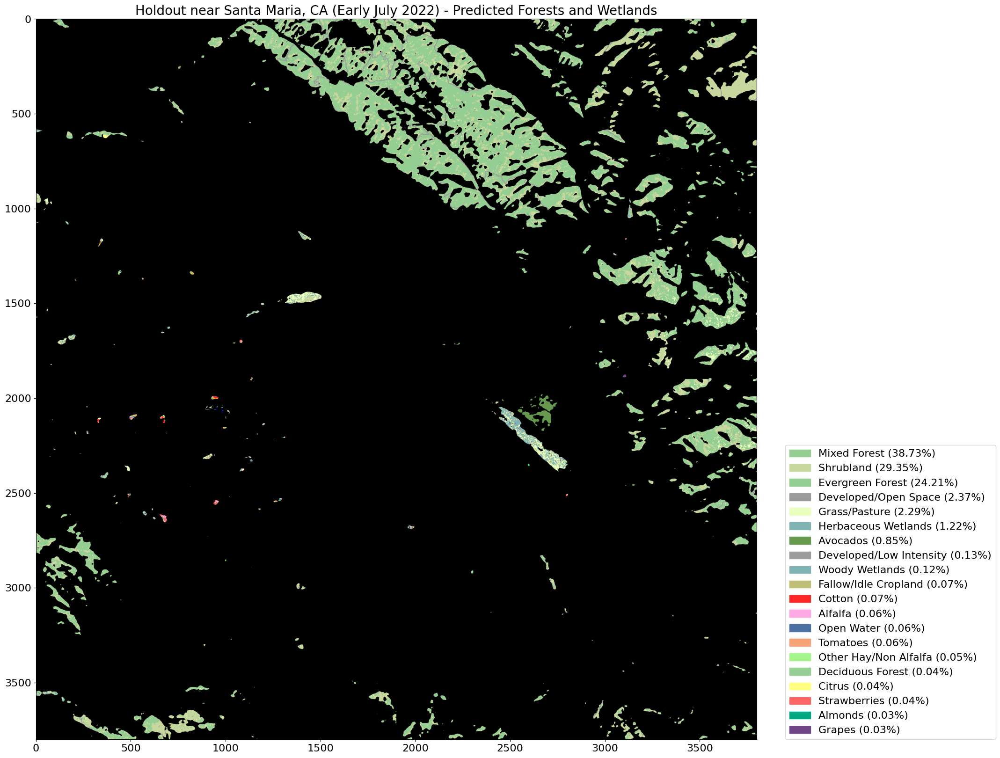

In [125]:
import matplotlib as mpl

mpl.rcParams['xtick.labelsize'] =16
mpl.rcParams['ytick.labelsize'] =16
fig, ax = plt.subplots(figsize = (20,20))

#gt_labels =  vec_translate(cdl_mask, code_class_dict)
#gt_labels = gt_labels[:tile_predict[1].shape[0],:tile_predict[1].shape[1],0]

cdl_tup = vec_translate(cdl_mask, rgb_dict)
cdl_img = np.array(cdl_tup)[:,:,:,0].transpose(1,2,0)
pred_mask = np.squeeze(1*tile_predict[1] == 7) #forest
pred_mask3 = np.array([pred_mask,pred_mask,pred_mask]).transpose(1,2,0)

print(pred_mask3.shape)

cdl_mask_trim =cdl_mask[:pred_mask.shape[0],:pred_mask.shape[1],0]
cdl_img_trim =cdl_img[:pred_mask.shape[0],:pred_mask.shape[1],:]


pixel_array = np.array(np.unique(pred_mask*cdl_mask_trim, return_counts = True)).T
pixels_ordered = pixel_array[pixel_array[:, 1].argsort()[::-1]]
df_pixel = pd.DataFrame(pixels_ordered, columns = ['code','count'])
df_pixel_join = df_pixel.merge(df_cdl_full.reset_index(), on = 'code')[['code', 'count', 'name', 'simple_class',
       'simple_class_numeric','rgb']]
df_pixel_join['perc'] = np.round(100.*df_pixel_join['count']/df_pixel_join[df_pixel_join['simple_class_numeric']!= 0]['count'].sum(),2)
df_pixel_join['name_perc'] = df_pixel_join.apply(lambda x: x['name'] + ' (' + str(x['perc']) + '%)',1)
df_pixel_join.loc[df_pixel_join.code == 0, 'name_perc'] = 'N/A'

names_colors_dict_mask = df_pixel_join.iloc[1:21][['name_perc','rgb']].set_index('name_perc').to_dict()['rgb']

ax.imshow(pred_mask3*cdl_img_trim)
labels_handles = list(zip(*[( nm, mpatches.Patch(color=np.array(cl)/255.)) for nm,cl in names_colors_dict_mask.items()]))
plt.legend(labels_handles[1], labels_handles[0], loc=(1.04, 0),prop={'size': 16})
plt.title('Holdout near Santa Maria, CA (Early July 2022) - Predicted Forests and Wetlands',size = 20)

(3800, 3800, 3)


Text(0.5, 1.0, 'Holdout near Santa Maria, CA (Early July 2022) - Developed')

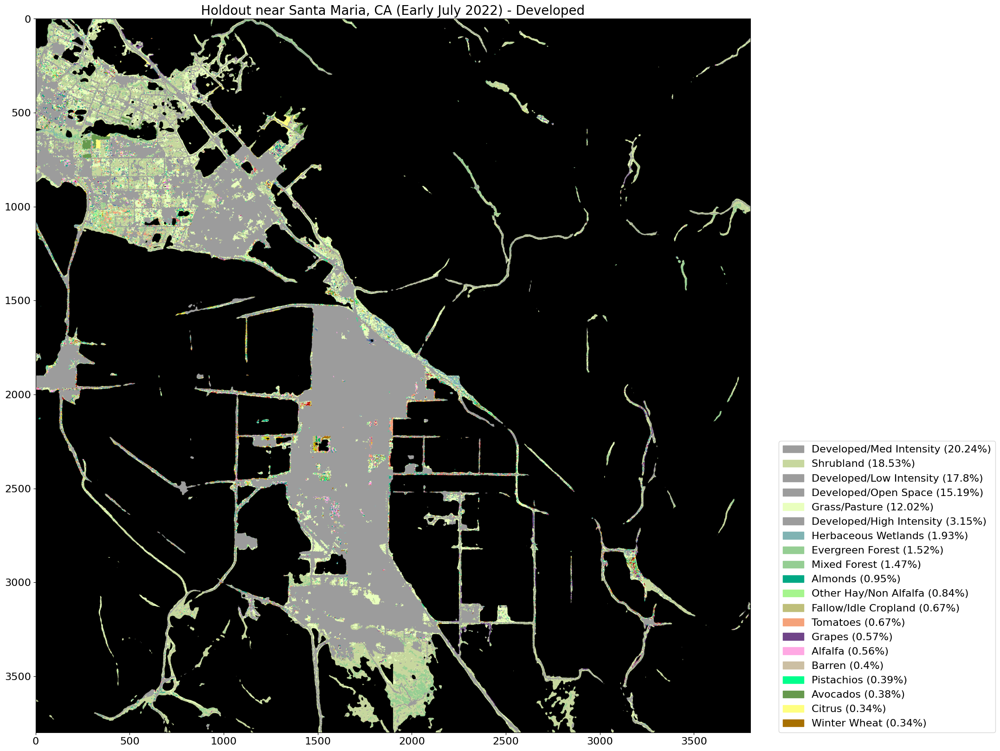

In [100]:
import matplotlib as mpl

mpl.rcParams['xtick.labelsize'] =16
mpl.rcParams['ytick.labelsize'] =16
fig, ax = plt.subplots(figsize = (20,20))
cdl_mask = np.expand_dims(img_mask_arr_sm[:,:,3],axis=2)
cdl_tup = vec_translate(cdl_mask, rgb_dict)
cdl_img = np.array(cdl_tup)[:,:,:,0].transpose(1,2,0)
pred_mask = np.squeeze(1*tile_predict[1] == 2)#developed
pred_mask3 = np.array([pred_mask,pred_mask,pred_mask]).transpose(1,2,0)
print(pred_mask3.shape)

cdl_mask_trim =cdl_mask[:pred_mask.shape[0],:pred_mask.shape[1],0]
cdl_img_trim =cdl_img[:pred_mask.shape[0],:pred_mask.shape[1],:]

#pred_img_mask =1*np.broadcast_to(pred_mask, cdl_img.shape) #pred_mask[:cdl_mask.shape[0],:cdl_mask.shape[1],:] #1*np.broadcast_to(pred_mask, cdl_img.shape)  

pixel_array = np.array(np.unique(pred_mask*cdl_mask_trim, return_counts = True)).T
pixels_ordered = pixel_array[pixel_array[:, 1].argsort()[::-1]]
df_pixel = pd.DataFrame(pixels_ordered, columns = ['code','count'])
df_pixel_join = df_pixel.merge(df_cdl_full.reset_index(), on = 'code')[['code', 'count', 'name', 'simple_class',
       'simple_class_numeric','rgb']]
df_pixel_join['perc'] = np.round(100.*df_pixel_join['count']/df_pixel_join[df_pixel_join['simple_class_numeric']!= 0]['count'].sum(),2)
df_pixel_join['name_perc'] = df_pixel_join.apply(lambda x: x['name'] + ' (' + str(x['perc']) + '%)',1)
df_pixel_join.loc[df_pixel_join.code == 0, 'name_perc'] = 'N/A'

names_colors_dict_mask = df_pixel_join.iloc[1:21][['name_perc','rgb']].set_index('name_perc').to_dict()['rgb']

ax.imshow(pred_mask3*cdl_img_trim)
labels_handles = list(zip(*[( nm, mpatches.Patch(color=np.array(cl)/255.)) for nm,cl in names_colors_dict_mask.items()]))
plt.legend(labels_handles[1], labels_handles[0], loc=(1.04, 0),prop={'size': 16})
plt.title('Holdout near Santa Maria, CA (Early July 2022) - Developed',size = 20)

In [39]:
%%time

bbox_springfield = [-90.029515,39.537755,-89.405483,39.907026]
  
img_mask_arr_july = divide_and_conquer(bbox_springfield, udf_fn=bounds_to_fusion,zm = 12)
img_arr_july = img_mask_arr_july[:,:,:3]

/home/gabriel/.local/lib/python3.10/site-packages/geopandas/geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)
/home/gabriel/.local/lib/python3.10/site-packages/rioxarray/_io.py:430: NodataShadowWarning: The dataset's nodata attribute is shadowing the alpha band. All masks will be determined by the nodata attribute
  out = riods.read(band_key, window=window, masked=self.masked)
/home/gabriel/.local/lib/python3.10/site-packages/xarray/core/common.py:165: RuntimeWarning: invalid value encountered in cast
  return np.asarray(self.values, dtype=dtype)
/home/gabriel/.local/lib/python3.10/site-packages/rioxarray/_io.py:430: NodataShadowWarning: The dataset's nodata attribute is shadowing the alpha band. All masks will be determined by the nodata attribute
  out = riods.

got pair list
img dims: 978 978
img loc: (-90.0439453125, 39.87601112764028)
CPU times: user 30.7 s, sys: 3.9 s, total: 34.6 s
Wall time: 22.9 s


Text(0.5, 1.0, 'Sentintel 2 Holdout Image: Near Springfield, IL (Early July 2022)')

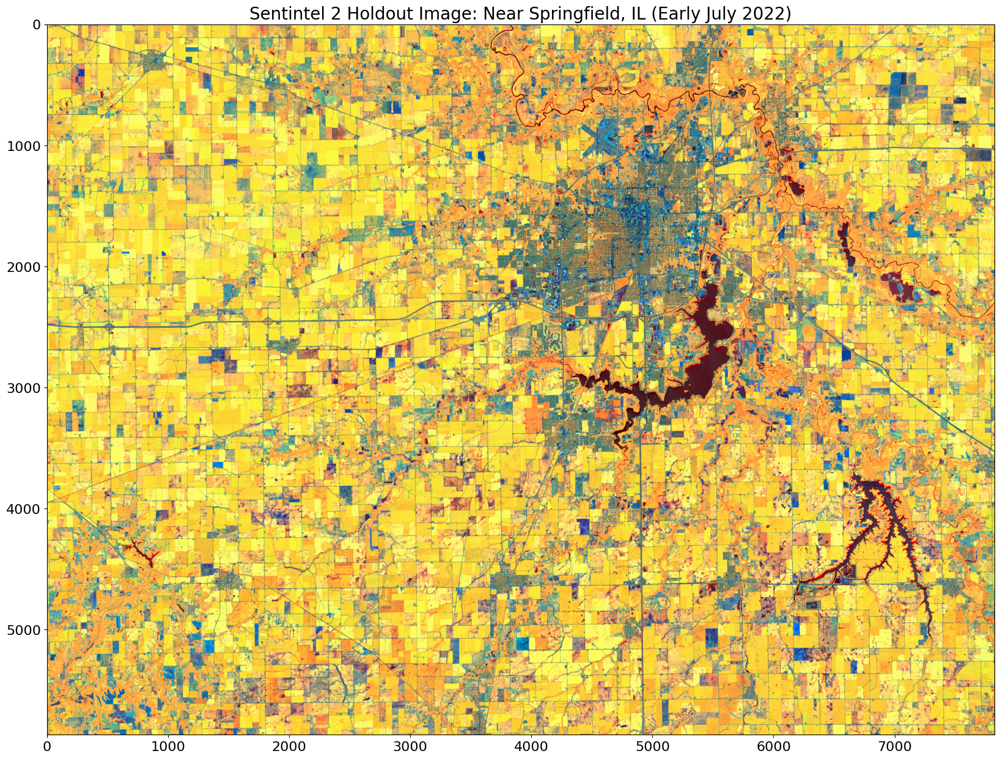

In [40]:
import matplotlib as mpl
mpl.rcParams['xtick.labelsize'] =16
mpl.rcParams['ytick.labelsize'] =16
fig, ax = plt.subplots(figsize = (20,20))
plt.imshow(img_arr_july)
plt.title('Sentintel 2 Holdout Image: Near Springfield, IL (Early July 2022)',size = 20)
#plt.savefig('springfield_july.png', bbox_inches='tight')

In [41]:
cdl_mask = np.expand_dims(img_mask_arr_july[:,:,3],axis=2)
cdl_mask.shape

def vec_translate(a, my_dict):
    return np.vectorize(my_dict.__getitem__)(a)
cdl_tup = vec_translate(cdl_mask, rgb_dict)
cdl_img = np.array(cdl_tup)[:,:,:,0].transpose(1,2,0)

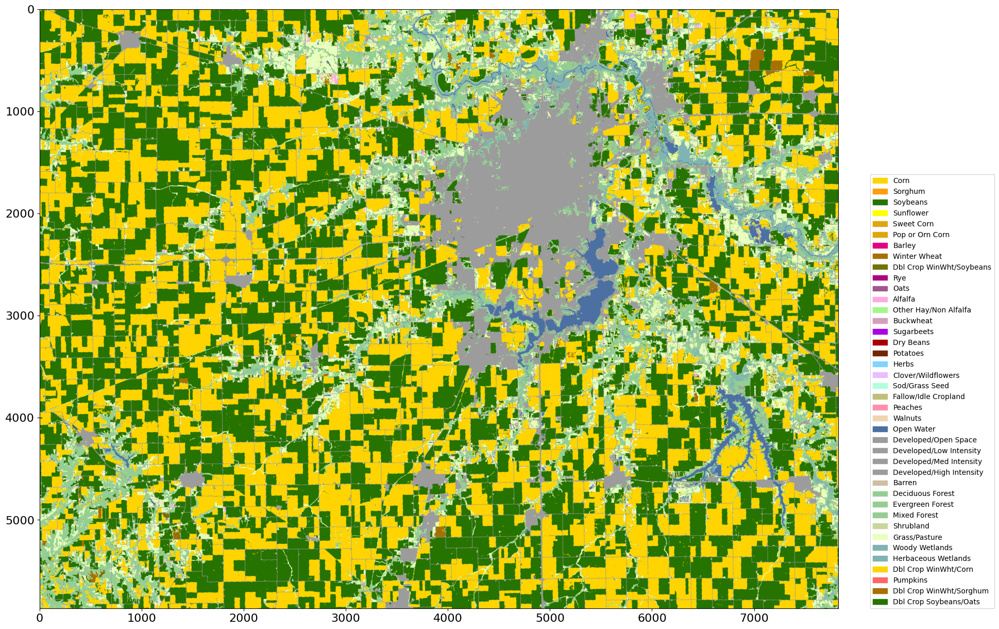

In [42]:
import matplotlib.patches as mpatches
fig, ax = plt.subplots(figsize = (20,20))
plt.imshow(cdl_img)
names_colors_dict = df_cdl_full[df_cdl_full.index.isin(np.unique(cdl_mask))][['name','rgb']].set_index('name').to_dict()['rgb']
labels_handles = list(zip(*[( nm, mpatches.Patch(color=np.array(cl)/255.)) for nm,cl in names_colors_dict.items()]))
plt.legend(labels_handles[1], labels_handles[0], loc=(1.04, 0),prop={'size': 10})

### holdout prediction

In [66]:
%%time
tile_predict_july = tile_and_predict(img_arr_july,test_model, d=978*2)

original image size: 7824 5868
tiled image size: 7824 5868
CPU times: user 1min 25s, sys: 4.56 s, total: 1min 30s
Wall time: 1min 7s


In [71]:
# cmap_simple = mpl.colors.LinearSegmentedColormap.from_list('cdl_cmap', named_color_array(name_list = ['white','blue','grey','yellow','green','brown','moccasin','olive','limegreen','orange']),10)
# cmap_simple

July IOU Mask2former:  [('BG', 0), ('OW', 71), ('DV', 61), ('CO', 85), ('SB', 79), ('WH', 5), ('OA', 1), ('FW', 58), ('OL', 24), ('OT', 3)]


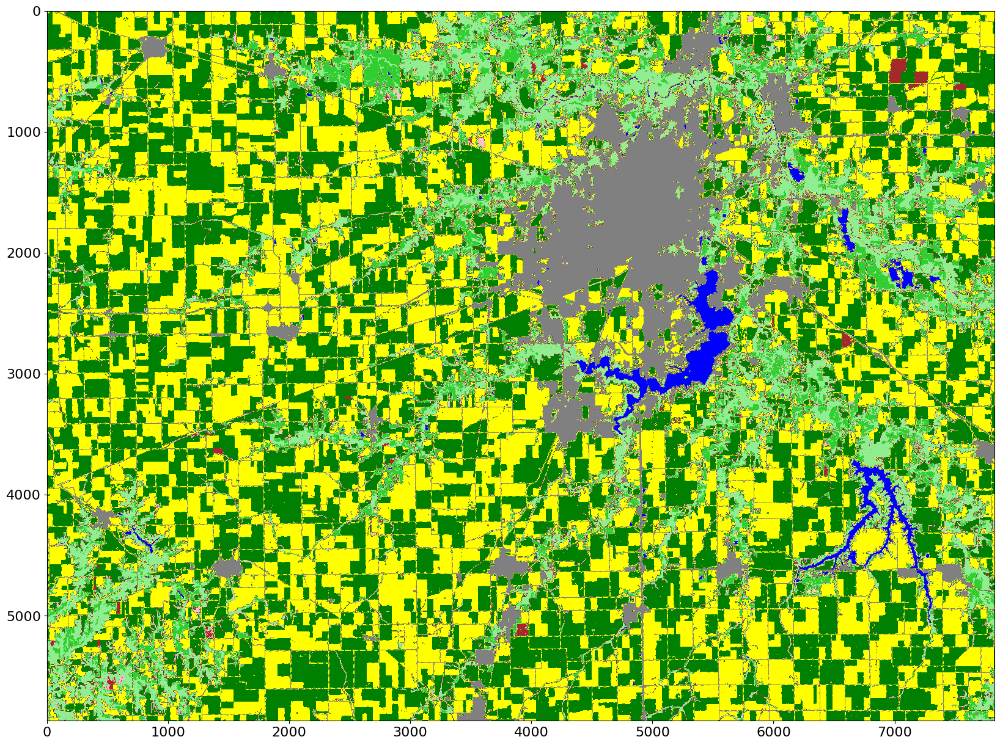

In [72]:
from sklearn.metrics import jaccard_score
tile_predict = tile_predict_july
MF_model_out = tile_predict[1]
cdl_mask = np.expand_dims(img_mask_arr_july[:,:,3],axis=2)
code_class_dict = df_cdl_full[['simple_class_numeric']].to_dict()['simple_class_numeric']

gt_labels =  vec_translate(cdl_mask, code_class_dict)

jax_array_MF = jaccard_score(np.round(gt_labels).reshape(-1),np.round(np.array(MF_model_out)).reshape(-1), average=None,labels = [0,1,2,3,4,5,6,7,8,9])
print("July IOU Mask2former: ",list(zip(class_list,np.array(100*jax_array_MF,'uint8'))))
np.array(100*jax_array_MF,'uint8')

fig, ax = plt.subplots(figsize = (20,20))
cdl_simple = vec_translate(cdl_mask, code_class_dict)
plt.imshow(cdl_simple, cmap=cmap_pinkgrapes, vmin = 0,vmax = 9) 

Text(0.5, 1.0, 'Holdout (near Springfield, IL): Corn Prediction Mask contains 89% Corn, 5% Soybeans, and trace other crops')

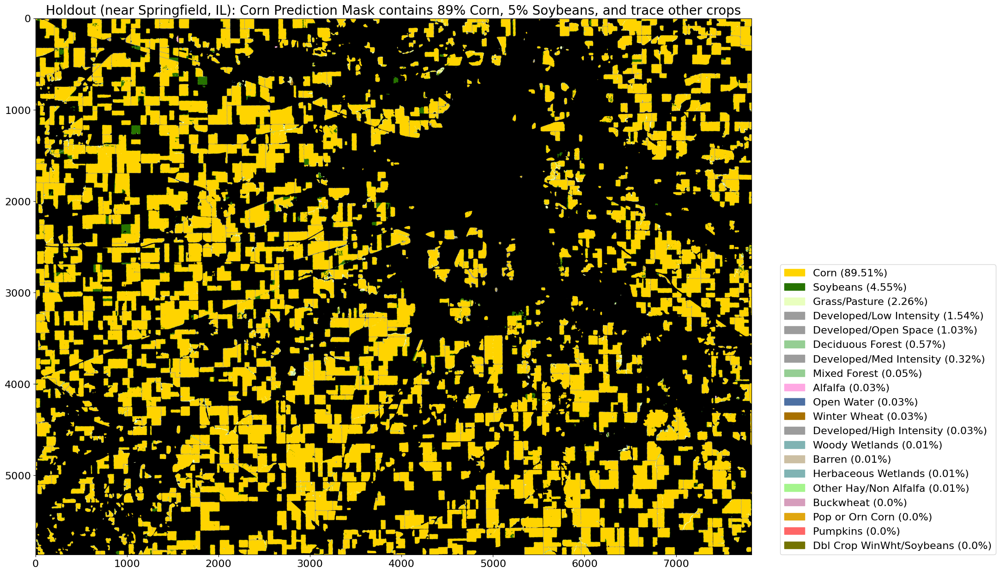

In [45]:
import matplotlib as mpl

mpl.rcParams['xtick.labelsize'] =16
mpl.rcParams['ytick.labelsize'] =16
fig, ax = plt.subplots(figsize = (20,20))
pred_mask = 1*tile_predict[1] ==3 #corn
pred_mask = pred_mask[..., np.newaxis]
pred_img_mask =1*np.broadcast_to(pred_mask, cdl_img.shape)   #corn prediction mask

pixel_array = np.array(np.unique(pred_img_mask*cdl_mask, return_counts = True)).T
pixels_ordered = pixel_array[pixel_array[:, 1].argsort()[::-1]]
df_pixel = pd.DataFrame(pixels_ordered, columns = ['code','count'])
df_pixel_join = df_pixel.merge(df_cdl_full.reset_index(), on = 'code')[['code', 'count', 'name', 'simple_class',
       'simple_class_numeric','rgb']]
df_pixel_join['perc'] = np.round(100.*df_pixel_join['count']/df_pixel_join[df_pixel_join['simple_class_numeric']!= 0]['count'].sum(),2)
df_pixel_join['name_perc'] = df_pixel_join.apply(lambda x: x['name'] + ' (' + str(x['perc']) + '%)',1)
df_pixel_join.loc[df_pixel_join.code == 0, 'name_perc'] = 'N/A'

names_colors_dict_mask = df_pixel_join.iloc[1:21][['name_perc','rgb']].set_index('name_perc').to_dict()['rgb']

ax.imshow(pred_img_mask*cdl_img)
labels_handles = list(zip(*[( nm, mpatches.Patch(color=np.array(cl)/255.)) for nm,cl in names_colors_dict_mask.items()]))
plt.legend(labels_handles[1], labels_handles[0], loc=(1.04, 0),prop={'size': 16})
plt.title('Holdout (near Springfield, IL): Corn Prediction Mask contains 89% Corn, 5% Soybeans, and trace other crops',size = 20)

Text(0.5, 1.0, 'Holdout (near Springfield, IL): Soybean Prediction Mask contains 95% Soybeans, and trace other crops')

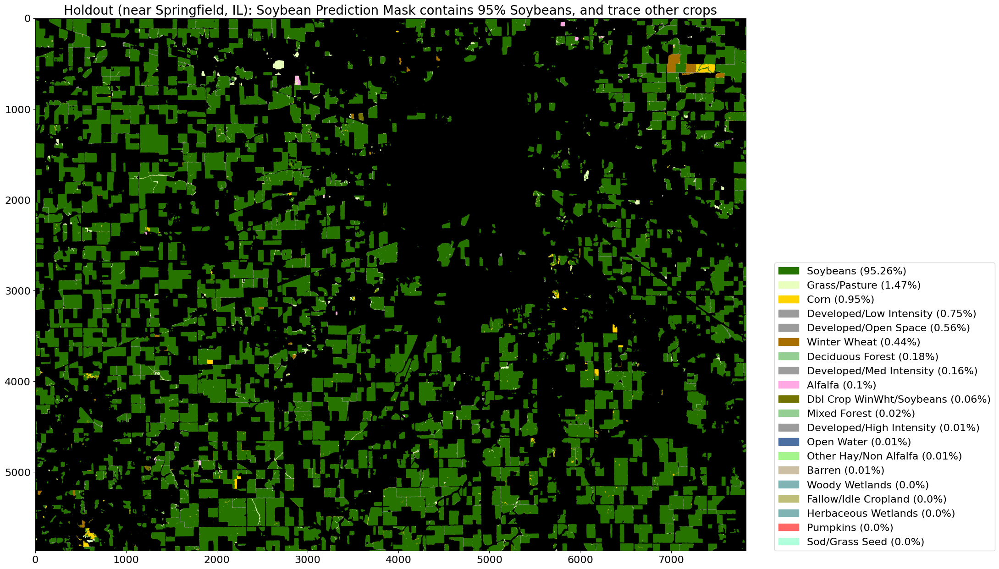

In [46]:
import matplotlib as mpl

mpl.rcParams['xtick.labelsize'] =16
mpl.rcParams['ytick.labelsize'] =16
fig, ax = plt.subplots(figsize = (20,20))
pred_mask = 1*tile_predict[1] ==4 #soybeans
pred_mask = pred_mask[..., np.newaxis]
pred_img_mask =1*np.broadcast_to(pred_mask, cdl_img.shape)   #corn prediction mask

pixel_array = np.array(np.unique(pred_img_mask*cdl_mask, return_counts = True)).T
pixels_ordered = pixel_array[pixel_array[:, 1].argsort()[::-1]]
df_pixel = pd.DataFrame(pixels_ordered, columns = ['code','count'])
df_pixel_join = df_pixel.merge(df_cdl_full.reset_index(), on = 'code')[['code', 'count', 'name', 'simple_class',
       'simple_class_numeric','rgb']]
df_pixel_join['perc'] = np.round(100.*df_pixel_join['count']/df_pixel_join[df_pixel_join['simple_class_numeric']!= 0]['count'].sum(),2)
df_pixel_join['name_perc'] = df_pixel_join.apply(lambda x: x['name'] + ' (' + str(x['perc']) + '%)',1)
df_pixel_join.loc[df_pixel_join.code == 0, 'name_perc'] = 'N/A'

names_colors_dict_mask = df_pixel_join.iloc[1:21][['name_perc','rgb']].set_index('name_perc').to_dict()['rgb']

ax.imshow(pred_img_mask*cdl_img)
labels_handles = list(zip(*[( nm, mpatches.Patch(color=np.array(cl)/255.)) for nm,cl in names_colors_dict_mask.items()]))
plt.legend(labels_handles[1], labels_handles[0], loc=(1.04, 0),prop={'size': 16})
plt.title('Holdout (near Springfield, IL): Soybean Prediction Mask contains 95% Soybeans, and trace other crops',size = 20)

Text(0.5, 1.0, 'Holdout (near Springfield, IL): Developed Land Prediction mask is composed of 72% Developed, 10% Grass, 10% Soybeans, 3% Corn, 3% Forest')

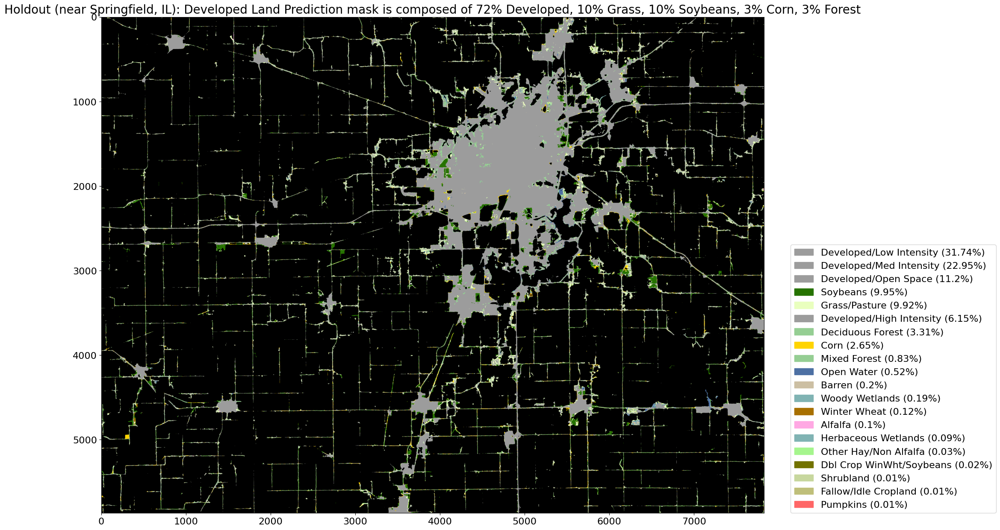

In [47]:
import matplotlib as mpl

mpl.rcParams['xtick.labelsize'] =16
mpl.rcParams['ytick.labelsize'] =16
fig, ax = plt.subplots(figsize = (20,20))
pred_mask = 1*tile_predict[1] ==2 #developed
pred_mask = pred_mask[..., np.newaxis]
pred_img_mask =1*np.broadcast_to(pred_mask, cdl_img.shape)   #corn prediction mask

pixel_array = np.array(np.unique(pred_img_mask*cdl_mask, return_counts = True)).T
pixels_ordered = pixel_array[pixel_array[:, 1].argsort()[::-1]]
df_pixel = pd.DataFrame(pixels_ordered, columns = ['code','count'])
df_pixel_join = df_pixel.merge(df_cdl_full.reset_index(), on = 'code')[['code', 'count', 'name', 'simple_class',
       'simple_class_numeric','rgb']]
df_pixel_join['perc'] = np.round(100.*df_pixel_join['count']/df_pixel_join[df_pixel_join['simple_class_numeric']!= 0]['count'].sum(),2)
df_pixel_join['name_perc'] = df_pixel_join.apply(lambda x: x['name'] + ' (' + str(x['perc']) + '%)',1)
df_pixel_join.loc[df_pixel_join.code == 0, 'name_perc'] = 'N/A'

names_colors_dict_mask = df_pixel_join.iloc[1:21][['name_perc','rgb']].set_index('name_perc').to_dict()['rgb']

ax.imshow(pred_img_mask*cdl_img)
labels_handles = list(zip(*[( nm, mpatches.Patch(color=np.array(cl)/255.)) for nm,cl in names_colors_dict_mask.items()]))
plt.legend(labels_handles[1], labels_handles[0], loc=(1.04, 0),prop={'size': 16})
plt.title('Holdout (near Springfield, IL): Developed Land Prediction mask is composed of 72% Developed, 10% Grass, 10% Soybeans, 3% Corn, 3% Forest',size = 20)

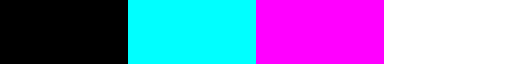

In [40]:
import matplotlib as mpl
from matplotlib import colors

def named_color_array(name_list = ['black','blue','grey','yellow','brown','moccasin','orange','darkgreen','limegreen','cyan']):
    return [colors.cnames[el] for el in name_list]

cmap_4col = mpl.colors.LinearSegmentedColormap.from_list('cdl_4col', named_color_array(name_list = ['black','cyan','magenta','white']),4)

cmap_4col

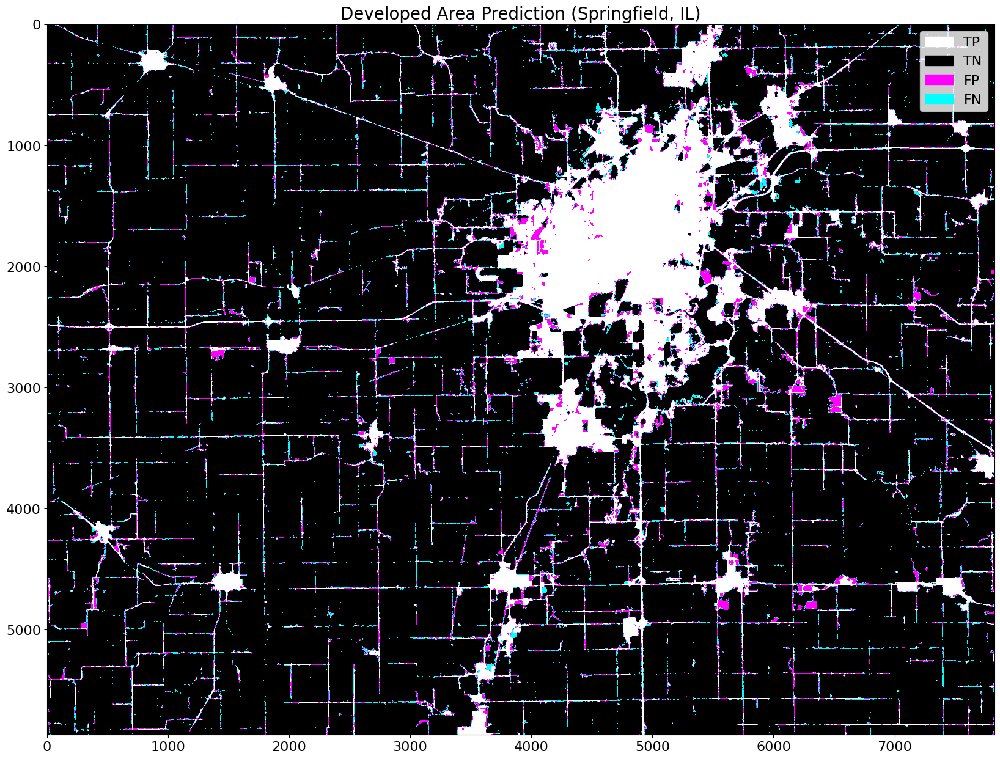

In [49]:
pred_mask = 1*tile_predict[1] ==2 #developed prediction
cdl_simple = vec_translate(cdl_mask, code_class_dict)
truth_mask = 1*cdl_simple[:,:,0]==2 #developed truth
img_mask_dv = truth_mask+ 2*pred_mask
mpl.rcParams['xtick.labelsize'] =16
mpl.rcParams['ytick.labelsize'] =16
fig, ax = plt.subplots(figsize = (20,20))
ax.imshow(img_mask_dv, cmap=cmap_4col, vmin = 0,vmax = 3)
ax.set_title('Developed Area Prediction (Springfield, IL)',size = 20)
TP_patch = mpatches.Patch(color='white', label='TP')
TN_patch = mpatches.Patch(color='black', label='TN')
FP_patch = mpatches.Patch(color='magenta', label='FP')
FN_patch = mpatches.Patch(color='cyan', label='FN')
plt.legend(handles=[TP_patch,TN_patch,FP_patch,FN_patch],fontsize = 16)

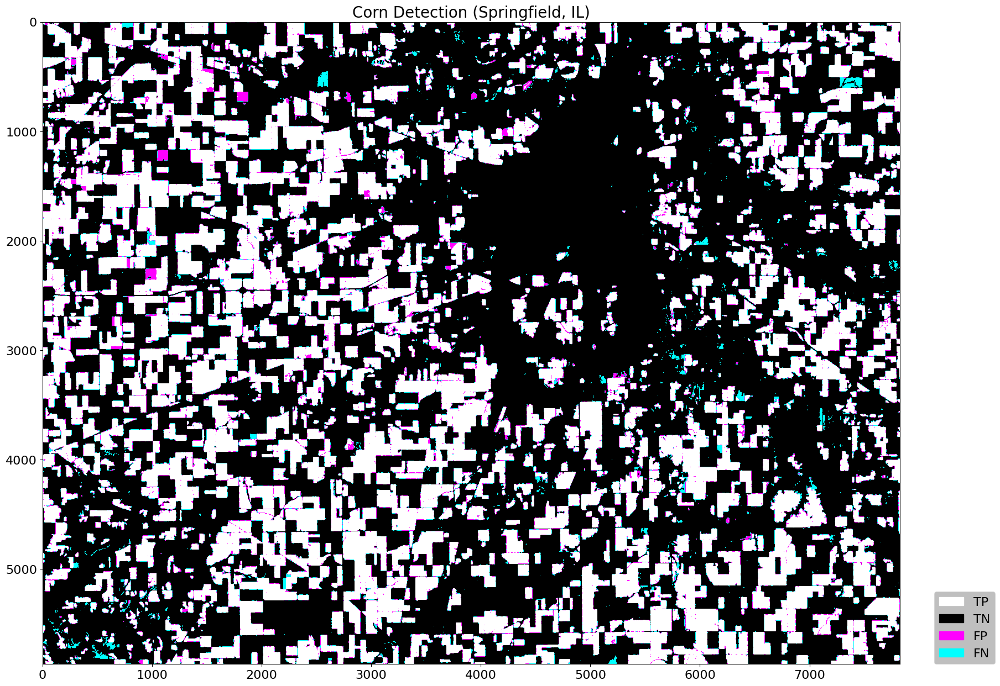

In [52]:
pred_mask = 1*tile_predict[1] ==3 #corn prediction
cdl_simple = vec_translate(cdl_mask, code_class_dict)
truth_mask = 1*cdl_simple[:,:,0]==3 #corn truth
img_mask_co = truth_mask+ 2*pred_mask
mpl.rcParams['xtick.labelsize'] =16
mpl.rcParams['ytick.labelsize'] =16
fig, ax = plt.subplots(figsize = (20,20))
ax.imshow(img_mask_co, cmap=cmap_4col, vmin = 0,vmax = 3)
ax.set_title('Corn Detection (Springfield, IL)',size = 20)
TP_patch = mpatches.Patch(color='white', label='TP')
TN_patch = mpatches.Patch(color='black', label='TN')
FP_patch = mpatches.Patch(color='magenta', label='FP')
FN_patch = mpatches.Patch(color='cyan', label='FN')
plt.legend(handles=[TP_patch,TN_patch,FP_patch,FN_patch],fontsize = 16, loc=(1.04, 0),facecolor='grey', framealpha=0.5)

In [53]:
device

device(type='cuda')